## Required images import

In [214]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

import numpy as np

original = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Original.jpg")
colored = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Original.jpg")
duplicate = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Original.jpg")
croped = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Croped.jpg")
recolored = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Recolored.jpg")
recolored2 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Recolored2.jpg")
rotated = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Rotated.jpg")
rotatedColored = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Rotated.jpg")
popart = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/PopArt.jpg")
resized = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Resized.jpg")
sharpened = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Sharpened.jpg")
sunburst = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Filtered Image/Sunburst.jpg")


_360pan = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Cutted Images/3d.jpg")
part1 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Cutted Images/3d_res.jpg")
part2 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Cutted Images/_80_340.jpg")
cubemap = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Cutted Images/cubemap.jpg")

moscowCubemap = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Moscow4k/cubemap.jpg")
moscowPart1 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/Moscow4k/Pieces/_60_320.jpg")

officePart1 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/360pans/Pieces/IMG_1274.jpg")
officePart2 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/360pans/Pieces/IMG_1275.jpg")
newPart1 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/360pans/Pieces/new4.jpg")
officePan = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/360pans/cubemap.jpg")

#Black and White
bawPart1 = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/360pans/Pieces/BlackAndWhite/part1.jpg")
bawCubemap = cv2.imread("/Users/amir/Desktop/ImageRecognition/Images/360pans/Pieces/BlackAndWhite/cubemap.jpg")

ya1 = cv2.imread("/Users/amir/Downloads/image.png")



img1 = original
img2 = croped


## Functions declarations

In [170]:
def showImage(img, size):
    plt.figure(figsize=(size, size))
    plt.imshow(img[:, :, ::-1], 'gray'),plt.show()

In [233]:
def drawPoints(points, img, mask):
    i = 0
    for point in points:
        if mask[i] == 1:
            (x1, y1) = (int(point[0]), int(point[1]))
           # print(x1, y1)
            cv2.line(img, (x1, y1), (x1, y1), (0,0,255),5)
        i += 1
    plt.figure(figsize=(100, 100))    
    plt.imshow(img[:, :, ::-1], 'gray'),plt.show()

In [246]:
def lookPixels(points, img, mask):
    minX = 100000
    minY = 100000
    maxX = 0
    maxY = 0
    i = 0
    for point in points:
        if mask[i] == 1:
            (x1, y1) = (int(point[0]), int(point[1]))
            maxX = max(maxX, x1)
            maxY = max(maxY, y1)
            minX = min(minX, x1)
            minY = min(minY, y1)
        i += 1
    result = (int((maxX-minX)/2 + minX), int((maxY-minY)/2+minY))    
    cv2.line(img, result, result, (255,255,255),5)
    showImage(img, 100)
    return result

In [259]:
def lookDegrees(points, img, mask):
    minX = 100000
    minY = 100000
    maxX = 0
    maxY = 0
    i = 0
    for point in points:
        if mask[i] == 1:
            (x1, y1) = (int(point[0]), int(point[1]))
            maxX = max(maxX, x1)
            maxY = max(maxY, y1)
            minX = min(minX, x1)
            minY = min(minY, y1)
        i += 1
    coordinates = (int((maxX-minX)/2 + minX), int((maxY-minY)/2+minY))    
    cv2.line(img, coordinates, coordinates, (255,255,255),5)
    showImage(img, 100)
    degree = 360/img.shape[0]
    print(str(degree))
    result = degree * coordinates[0]
    return result

In [260]:
def drawMatches(img1, kp1, img2, kp2, good, matchesMask):
    draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                       singlePointColor = None,
                       matchesMask = matchesMask, # draw only inliers
                       flags = 2)

    img = cv2.drawMatches(img1, kp1, img2, kp2, good, None, **draw_params)

    plt.figure(figsize=(100, 100))
    plt.imshow(img[:, :, ::-1], 'gray'),plt.show()

In [202]:
def process_sift(img1, img2):
    MIN_MATCH_COUNT = 10

    # Initiate SIFT detector
    sift = cv2.xfeatures2d.SIFT_create()

    # find the keypoints and descriptors with SIFT
    global kp1
    global kp2
    kp1, des1 = sift.detectAndCompute(img1,None)
    kp2, des2 = sift.detectAndCompute(img2,None)

    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 50)

    flann = cv2.FlannBasedMatcher(index_params, search_params)

    global matches
    matches = flann.knnMatch(des1,des2,k=2)

    # store all the good matches as per Lowe's ratio test.
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append(m)
    
    good = good[::10]
    if len(good)>MIN_MATCH_COUNT:
        src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
        dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)
        global matchesMask
        matchesMask = mask.ravel().tolist()
        
        
        h,w,z = img1.shape
        pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
        dst = cv2.perspectiveTransform(pts,M)

        img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)
        print('success')
    else:
        print('FAIL')
        matchesMask = None 
    
    drawMatches(img1, kp1, img2, kp2, good, matchesMask)
    return matchesMask
     

## Executable part

success


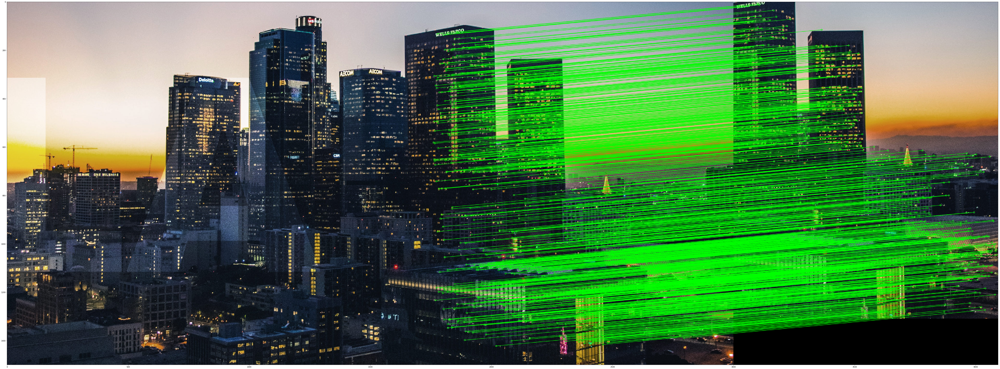

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


In [215]:
kp1, kp2, matches, matchesMask
process_sift(img1, img2)

In [208]:
points1 = [kp1[mat.queryIdx].pt for mat in good] 
points2 = [kp2[mat.trainIdx].pt for mat in good]


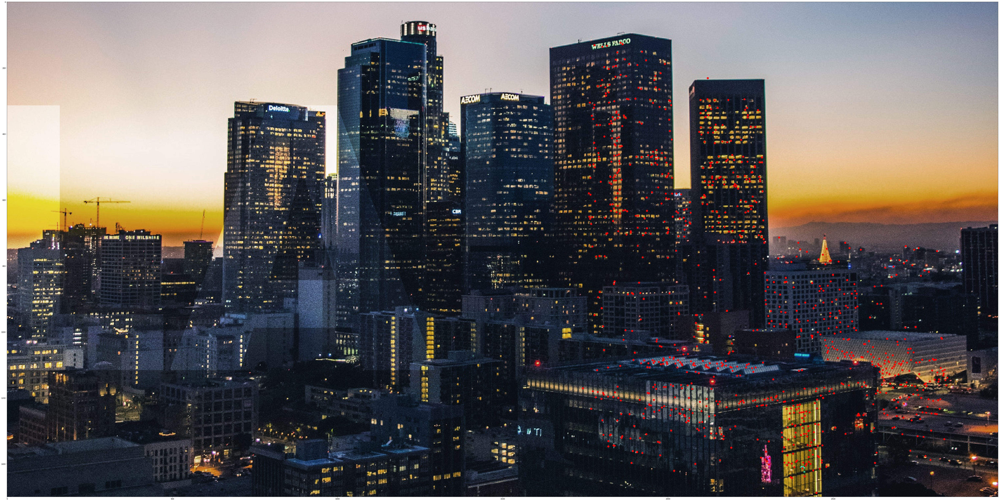

In [247]:
drawPoints(points1, img1, matchesMask)

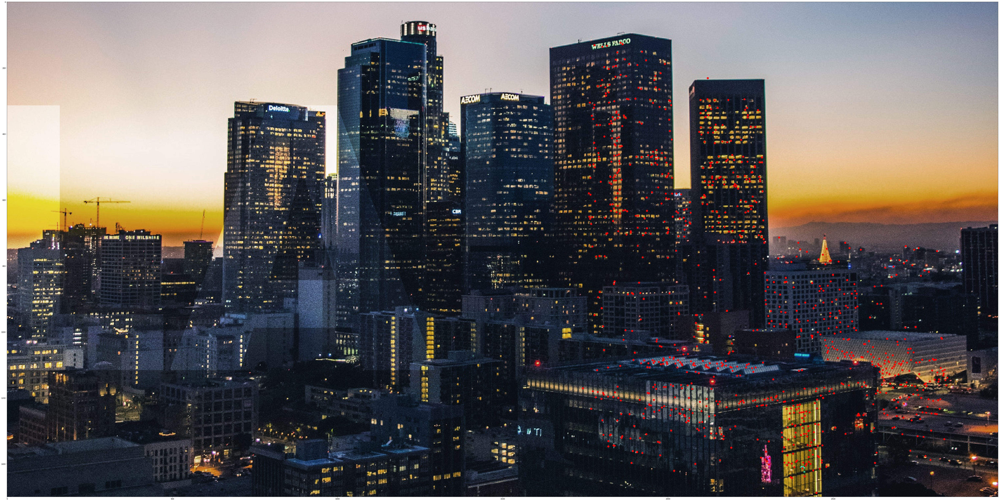

(2303, 772)

In [248]:
lookPixels(points1, img1, matchesMask)

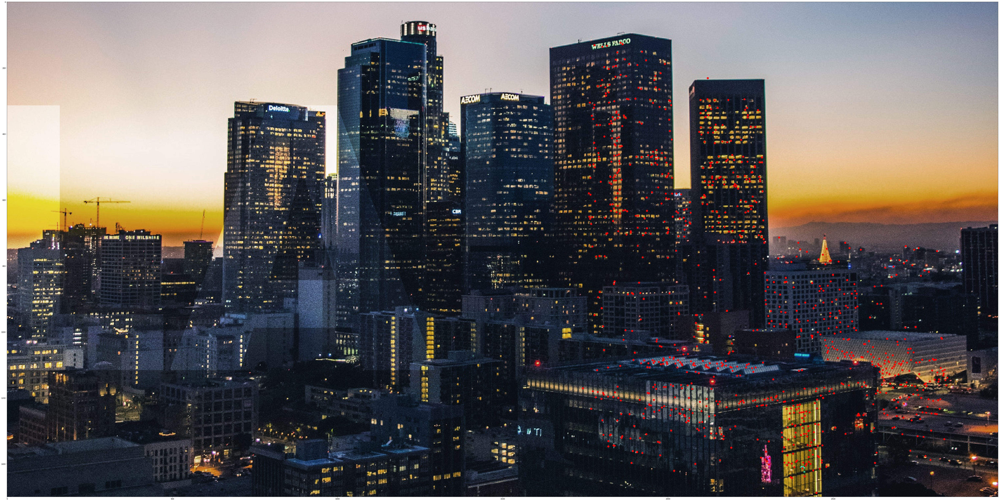

0.24


552.72

In [261]:
lookDegrees(points1, img1, matchesMask)

In [212]:
i = 0
for point in points2:
    i += 1
    print(i)
    if matchesMask[i] == 1:
        (x1, y1) = (int(point[0]), int(point[1]))
        print(x1, y1)
        cv2.line(img2, (x1, y1), (x1, y1), (255,0,0),5)
plt.figure(figsize=(100, 100))    
plt.imshow(img2[:, :, ::-1], 'gray'),plt.show()

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
16 1057
24
4 464
25
6 535
26
7 378
27
7 189
28
8 541
29
9 468
30
9 417
31
11 557
32
11 1117
33
13 229
34
14 536
35
15 625
36
16 1064
37
17 239
38
18 376
39
19 205
40
20 311
41
20 833
42
21 15
43
21 196
44
22 384
45
23 488
46
24 327
47
25 1082
48
26 656
49
28 257
50
29 1000
51
31 139
52
31 1066
53
32 779
54
33 342
55
34 353
56
35 361
57
36 654
58
37 763
59
38 257
60
40 138
61
40 429
62
42 1087
63
43 812
64
44 121
65
45 20
66
45 1152
67
47 867
68
47 1069
69
48 1196
70
49 1074
71
50 939
72
51 292
73
51 81
74
52 655
75
53 538
76
54 143
77
55 161
78
56 168
79
57 587
80
59 17
81
60 585
82
62 1080
83
62 992
84
63 1215
85
63 1231
86
64 159
87
64 87
88
65 189
89
66 254
90
67 432
91
67 135
92
68 1197
93
68 415
94
69 498
95
70 1195
96
71 517
97
71 245
98
72 436
99
72 368
100
73 252
101
74 297
102
75 275
103
76 497
104
76 233
105
77 548
106
78 1081
107
78 80
108
79 416
109
79 1228
110
80 425
111
80 510
112
80 739
113
81 350
114
81 185
115

1069 993
1002
1071 902
1003
1073 905
1004
1075 1002
1005
1077 1016
1006
1078 1010
1007
1080 1209
1008
1081 999
1009
1083 1030
1010
1086 1046
1011


IndexError: list index out of range